In [64]:
import numpy as np
import tensorflow as tf
from pathlib import Path
import math
import matplotlib.pyplot as plt
import random
import shutil

ImageDataGenerator = tf.keras.preprocessing.image.ImageDataGenerator
Model = tf.keras.models.Model
Input = tf.keras.layers.Input
Conv2D = tf.keras.layers.Conv2D
MaxPooling2D = tf.keras.layers.MaxPooling2D
UpSampling2D = tf.keras.layers.UpSampling2D
# TARGET_SIZE = (1920, 1080)
TARGET_SIZE = (224, 224)


# Function to load and preprocess images for training
def load_and_preprocess_images(
    directory,
    target_size=TARGET_SIZE,
    batch_size=32,
    subset_fraction=None,
    subset_number=None,
):
    datagen = ImageDataGenerator(
        rescale=1.0 / 255,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode="nearest",
    )

    subset_filenames = list(Path(directory).glob("*/*"))
    random.shuffle(subset_filenames)

    if subset_fraction is not None:
        subset_size = math.ceil(subset_fraction * len(subset_filenames))
    elif subset_number is not None:
        subset_size = min(subset_number, len(subset_filenames))
    else:
        subset_size = len(subset_filenames)

    subset_filenames = subset_filenames[:subset_size]

    temp_dir = Path(directory).parent / "temp_subset" / "class_1"
    temp_dir.mkdir(exist_ok=True, parents=True)

    base_path = Path(directory)

    subset_filenames = [
        base_path / "class_1" / filename
        for filename in [
            "18_014.png",
            "18_013.png",
            "18_012.png",
            "18_011.png",
            "18_010.png",
        ]
    ]

    for filename in subset_filenames:
        shutil.copy(filename, temp_dir)

    directory = temp_dir.parent

    generator = datagen.flow_from_directory(
        directory,
        target_size=target_size,
        batch_size=batch_size,
        class_mode="input",
        shuffle=True,
    )
    for images, _ in generator:
        paths = [Path(directory) / Path(path) for path in generator.filenames]
        yield images, paths


# Function to load images for assessment without augmentation
def load_images_for_assessment(directory, target_size=TARGET_SIZE, batch_size=32):
    datagen = ImageDataGenerator(rescale=1.0 / 255)
    generator = datagen.flow_from_directory(
        directory,
        target_size=target_size,
        batch_size=batch_size,
        class_mode="input",
        shuffle=False,
    )

    for images, _ in generator:
        paths = [Path(directory) / Path(path) for path in generator.filenames]
        yield images, paths


# Building the autoencoder
def build_autoencoder(input_shape):
    input_img = Input(shape=input_shape)
    x = Conv2D(32, (3, 3), activation="relu", padding="same")(input_img)
    x = MaxPooling2D((2, 2), padding="same")(x)
    x = Conv2D(16, (3, 3), activation="relu", padding="same")(x)
    encoded = MaxPooling2D((2, 2), padding="same")(x)

    x = Conv2D(16, (3, 3), activation="relu", padding="same")(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(32, (3, 3), activation="relu", padding="same")(x)
    x = UpSampling2D((2, 2))(x)
    decoded = Conv2D(3, (3, 3), activation="sigmoid", padding="same")(x)

    autoencoder = Model(input_img, decoded)
    autoencoder.compile(optimizer="adam", loss="binary_crossentropy")

    return autoencoder


# Training the autoencoder
def train_autoencoder(autoencoder, train_generator, epochs=50, steps_per_epoch=200):
    # autoencoder.fit(train_generator, epochs=epochs, steps_per_epoch=steps_per_epoch)
    all_image_paths = []
    for _ in range(epochs):
        for _ in range(steps_per_epoch):
            images, paths = next(train_generator)
            autoencoder.train_on_batch(images, images)
            all_image_paths.extend(paths)

    return all_image_paths


# Feature extraction and anomaly detection
def get_encoded_images(model, data_generator):
    encoder = Model(inputs=model.input, outputs=model.get_layer(index=4).output)
    encoded_images = encoder.predict(data_generator)
    return encoded_images


def get_reconstruction_error(model, data):
    reconstructed = model.predict(data)
    reconstruction_error = np.mean(np.abs(data - reconstructed), axis=(1, 2, 3))
    return reconstruction_error


# Function to calculate the reconstruction error
def calculate_reconstruction_error(model, generator, steps):
    all_reconstruction_errors = []
    all_paths = []

    # Loop over the generator to process all images
    for _ in range(steps):
        images, paths = next(generator)
        reconstructed = model.predict(
            images
        )  # Reconstruct the images using the autoencoder
        batch_reconstruction_error = np.mean(
            np.abs(images - reconstructed), axis=(1, 2, 3)
        )

        all_reconstruction_errors.extend(batch_reconstruction_error)
        all_paths.extend(paths)

    return list(zip(all_paths, all_reconstruction_errors))

In [65]:
# Define paths to your datasets
train_dir = Path("../../data/one_class_dataset/train")
train_steps_per_epoch = math.ceil(len(list(train_dir.glob("*/*"))) / 32)
validate_dir = Path("../../data/one_class_dataset/validate")
validate_dir_steps_per_epoch = math.ceil(len(list(validate_dir.glob("*/*"))) / 32)

In [66]:
# Load and preprocess images
SUBSET_NUMBER = 5
train_steps_per_epoch = math.ceil(SUBSET_NUMBER / 32)
train_generator = load_and_preprocess_images(train_dir, subset_number=SUBSET_NUMBER)
assessment_generator = load_images_for_assessment(validate_dir)

In [67]:
# Build and train the autoencoder
autoencoder = build_autoencoder((*TARGET_SIZE, 3))
#* epochs has a big impact on the results
training_images = train_autoencoder(
    autoencoder, train_generator, epochs=100, steps_per_epoch=train_steps_per_epoch
)
training_images = training_images[:SUBSET_NUMBER]

Found 5 images belonging to 1 classes.


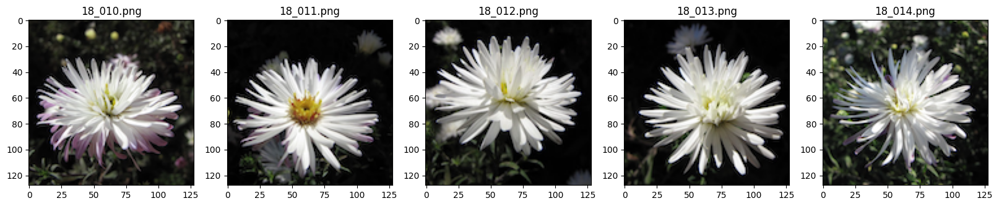

In [68]:
def display_images(paths, cols=5):
    rows = math.ceil(len(paths) / cols)
    fig, ax = plt.subplots(rows, cols, figsize=(20, 20))
    for i, path in enumerate(paths):
        img = plt.imread(path)
        if rows == 1:
            ax[i % cols].imshow(img)
            ax[i % cols].set_title(path.name)
        else:
            ax[i // cols, i % cols].imshow(img)
            ax[i // cols, i % cols].set_title(path.name)
    plt.show()


display_images(training_images)


if (train_dir.parent / "temp_subset").exists():
    shutil.rmtree(train_dir.parent / "temp_subset")

In [69]:
reconstruction_error = calculate_reconstruction_error(
    autoencoder, assessment_generator, validate_dir_steps_per_epoch
)

Found 301 images belonging to 1 classes.
1/1 [==============================] - 0s 101ms/step


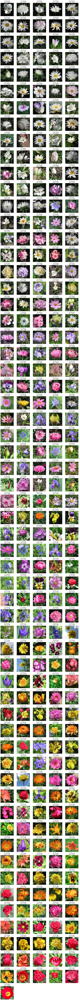

In [70]:
def display_images_with_labels_and_errors(paths, errors, cols=5):
    num_images = len(paths)
    rows = math.ceil(num_images / cols)

    _, axes = plt.subplots(rows, cols, figsize=(15, rows * 3))
    axes = axes.flatten()

    for i in range(num_images):
        axes[i].imshow(plt.imread(paths[i]))
        axes[i].set_title(f"{paths[i].name}\nError: {errors[i]:.4f}")
        axes[i].axis("off")

    for j in range(num_images, len(axes)):
        axes[j].axis("off")

    plt.tight_layout()
    plt.show()


reconstruction_error.sort(key=lambda x: x[1])

paths, errors = zip(*reconstruction_error)

display_images_with_labels_and_errors(paths, errors, cols=5)